In [1]:
import pandas as pd
# import numpy as np
import matplotlib.pyplot as plt
import vectorbtpro as vbt
# from numba import njit

/Users/ericervin/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/numba/core/decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)


In [2]:
vbt.settings.plotting["layout"]["template"] = "vbt_dark"
vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 350
vbt.settings.wrapping["freq"] = "1m"
# vbt.settings.portfolio['size_granularity'] = 0.001
vbt.settings.portfolio['init_cash'] = 10000

In [3]:
# Read in the 1 minute data from my HDF5 file
data = vbt.Data.from_hdf('data.hdf5')
print(type(data)) # <class 'vectorbt.base.data.Data'>

# The data is a vbt object, run the .get() method to get the underlying pandas dataframe
btc_1m = data.get()
print(type(btc_1m)) # <class 'pandas.core.frame.DataFrame'>
# Set columns to lowercase
btc_1m.columns = btc_1m.columns.str.lower()
# Print out the tail for sanity check
btc_1m.tail()

<class 'vectorbtpro.data.base.Data'>
<class 'pandas.core.frame.DataFrame'>


,open,high,low,close,volume,quote volume,trade count,taker base volume,taker quote volume
Open time,,,,,,,,,
2023-05-16 19:52:00+00:00,26946.95,26965.39,26934.77,26934.77,31.36557,8.454722e+05,887,10.69658,2.883069e+05
2023-05-16 19:53:00+00:00,26934.78,26944.74,26920.37,26928.32,32.24925,8.685570e+05,892,10.35741,2.789306e+05
2023-05-16 19:54:00+00:00,26928.32,26932.21,26914.34,26914.35,34.86987,9.387789e+05,852,10.52570,2.833605e+05
2023-05-16 19:55:00+00:00,26914.34,26922.63,26880.00,26922.63,143.63646,3.863386e+06,2953,63.60396,1.710808e+06
2023-05-16 19:56:00+00:00,26922.63,26960.24,26910.42,26954.14,71.70244,1.931970e+06,1339,44.88247,1.209301e+06


## Mess around with standard deviation

In [4]:
# Create a rolling standard deviation series based on the closing price
std_dev = btc_1m['close'].rolling('1D').std() # Could also use 1440 instead of 1D same result
std_dev

Open time
2021-01-01 00:00:00+00:00           NaN
2021-01-01 00:01:00+00:00     34.117902
2021-01-01 00:02:00+00:00     24.210205
2021-01-01 00:03:00+00:00     19.882332
2021-01-01 00:04:00+00:00     17.817179
                                ...    
2023-05-16 19:52:00+00:00    119.014179
2023-05-16 19:53:00+00:00    118.859373
2023-05-16 19:54:00+00:00    118.727719
2023-05-16 19:55:00+00:00    118.600811
2023-05-16 19:56:00+00:00    118.438800
Name: close, Length: 1245724, dtype: float64

In [5]:
# Look at the last N days and get the average
stdev_lbw = '30D' # '7D' for 7 day lookback, '30D' for 30 days to smooth it out Lookback window for standard deviation smoothing
std_dev_daily_mean = std_dev.rolling(stdev_lbw).mean()

In [6]:
# Show the standard deviation at midnight
std_dev_daily_mean.at_time('00:00').tail(20)

Open time
2023-04-27 00:00:00+00:00    210.596890
2023-04-28 00:00:00+00:00    219.312591
2023-04-29 00:00:00+00:00    213.457176
2023-04-30 00:00:00+00:00    208.721860
2023-05-01 00:00:00+00:00    204.135366
2023-05-02 00:00:00+00:00    211.486673
2023-05-03 00:00:00+00:00    216.456863
2023-05-04 00:00:00+00:00    216.232182
2023-05-05 00:00:00+00:00    218.296673
2023-05-06 00:00:00+00:00    217.724983
2023-05-07 00:00:00+00:00    220.167798
2023-05-08 00:00:00+00:00    222.890878
2023-05-09 00:00:00+00:00    231.675341
2023-05-10 00:00:00+00:00    234.520579
2023-05-11 00:00:00+00:00    231.804093
2023-05-12 00:00:00+00:00    222.674630
2023-05-13 00:00:00+00:00    228.526435
2023-05-14 00:00:00+00:00    230.508052
2023-05-15 00:00:00+00:00    225.372154
2023-05-16 00:00:00+00:00    227.051857
Name: close, dtype: float64

<Axes: >

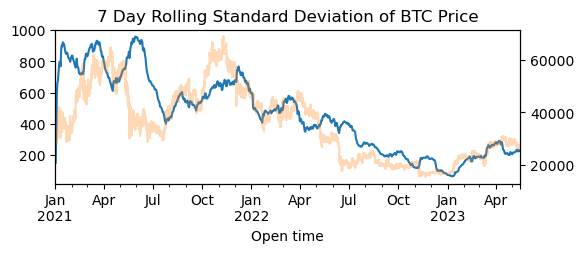

In [7]:
std_dev_daily_mean.at_time('00:00').plot(figsize=(6, 2), title='7 Day Rolling Standard Deviation of BTC Price')
# Plot the BTC price on a secondary axis to see how it correlates
btc_1m['close'].plot(secondary_y=True, alpha=0.3)

In [8]:
# Join the midnight 7 day mean to the original dataframe and fill forward
btc_1m = btc_1m.join(std_dev_daily_mean.at_time('00:00'), rsuffix='_daily_mean')
btc_1m['rolling_std_dev_daily_mean'] = std_dev_daily_mean # I added this so we could check things
# btc_1m = btc_1m.ffill()


In [9]:
# Forward fill the missing values in column
btc_1m['close_daily_mean'] = btc_1m['close_daily_mean'].ffill()
btc_1m.tail()

,open,high,low,close,volume,quote volume,trade count,taker base volume,taker quote volume,close_daily_mean,rolling_std_dev_daily_mean
Open time,,,,,,,,,,,
2023-05-16 19:52:00+00:00,26946.95,26965.39,26934.77,26934.77,31.36557,8.454722e+05,887,10.69658,2.883069e+05,227.051857,229.616018
2023-05-16 19:53:00+00:00,26934.78,26944.74,26920.37,26928.32,32.24925,8.685570e+05,892,10.35741,2.789306e+05,227.051857,229.617570
2023-05-16 19:54:00+00:00,26928.32,26932.21,26914.34,26914.35,34.86987,9.387789e+05,852,10.52570,2.833605e+05,227.051857,229.619116
2023-05-16 19:55:00+00:00,26914.34,26922.63,26880.00,26922.63,143.63646,3.863386e+06,2953,63.60396,1.710808e+06,227.051857,229.620658
2023-05-16 19:56:00+00:00,26922.63,26960.24,26910.42,26954.14,71.70244,1.931970e+06,1339,44.88247,1.209301e+06,227.051857,229.622195


## Instead of doing it manually Let's write a function

In [10]:
# Create daily support and resistance levels function
def add_support_resistance(df: pd.DataFrame, 
                           close_col: str = 'close', 
                           std_dev_col: str = 'rolling_std_dev_daily_mean', 
                           low_sigma: int = 1, 
                           high_sigma: int = 6, 
                           sigma_step: int = 1) -> pd.DataFrame:
    df['open_line'] = df[close_col].at_time('00:00')
    df['open_line'] = df['open_line'].ffill()
    for sigma in range(low_sigma, high_sigma+1, sigma_step):
        df[f'daily_support_{sigma}'] = df[close_col].at_time('00:00') - (df[std_dev_col].at_time('00:00') * sigma)
        df[f'daily_support_{sigma}'] = df[f'daily_support_{sigma}'].ffill()
        
        df[f'daily_resistance_{sigma}'] = df[close_col].at_time('00:00') + (df[std_dev_col].at_time('00:00') * sigma)
        df[f'daily_resistance_{sigma}'] = df[f'daily_resistance_{sigma}'].ffill()
    return df

In [11]:
# Create a new copy of the dataframe with all the sigmas added
df_with_sigmas_added = add_support_resistance(btc_1m)
df_with_sigmas_added

,open,high,low,close,volume,quote volume,trade count,taker base volume,taker quote volume,close_daily_mean,...,daily_support_2,daily_resistance_2,daily_support_3,daily_resistance_3,daily_support_4,daily_resistance_4,daily_support_5,daily_resistance_5,daily_support_6,daily_resistance_6
Open time,,,,,,,,,,,,,,,,,,,,,
2021-01-01 00:00:00+00:00,28923.63,28961.66,28913.12,28961.66,27.457032,7.943820e+05,1292,16.777195,4.853908e+05,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:01:00+00:00,28961.67,29017.50,28961.01,29009.91,58.477501,1.695803e+06,1651,33.733818,9.781765e+05,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:02:00+00:00,29009.54,29016.71,28973.58,28989.30,42.470329,1.231359e+06,986,13.247444,3.840769e+05,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:03:00+00:00,28989.68,28999.85,28972.33,28982.69,30.360677,8.800168e+05,959,9.456028,2.740831e+05,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:04:00+00:00,28982.67,28995.93,28971.80,28975.65,24.124339,6.992262e+05,726,6.814644,1.975194e+05,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-16 19:52:00+00:00,26946.95,26965.39,26934.77,26934.77,31.365570,8.454722e+05,887,10.696580,2.883069e+05,227.051857,...,26720.166287,27628.373713,26493.11443,27855.42557,26266.062573,28082.477427,26039.010717,28309.529283,25811.95886,28536.58114
2023-05-16 19:53:00+00:00,26934.78,26944.74,26920.37,26928.32,32.249250,8.685570e+05,892,10.357410,2.789306e+05,227.051857,...,26720.166287,27628.373713,26493.11443,27855.42557,26266.062573,28082.477427,26039.010717,28309.529283,25811.95886,28536.58114
2023-05-16 19:54:00+00:00,26928.32,26932.21,26914.34,26914.35,34.869870,9.387789e+05,852,10.525700,2.833605e+05,227.051857,...,26720.166287,27628.373713,26493.11443,27855.42557,26266.062573,28082.477427,26039.010717,28309.529283,25811.95886,28536.58114


In [12]:
# Create a plotting function that will let you plot the support and resistance lines over a given range of dates

def plot_daily_support_resistance(df: pd.DataFrame, 
                                  close_col: str = 'close', 
                                  low_sigma: int = 1, 
                                  high_sigma: int = 6, 
                                  from_date: str = None, 
                                  to_date: str = None):
    # If dates are provided, select that range from the dataframe
    if from_date and to_date:
        df = df.loc[from_date : to_date]
    else:
        df = df.iloc[-4*1440:]
    
    plt.figure(figsize=(14,7))
    
    # Plot close price
    plt.plot(df.index, df[close_col], label='Close Price', color='blue')

    # Plot support and resistance lines
    for sigma in range(low_sigma, high_sigma + 1):
        plt.plot(df.index, df[f'daily_support_{sigma}'], label=f'Support {sigma}σ', linestyle='--', alpha=0.3)
        plt.plot(df.index, df[f'daily_resistance_{sigma}'], label=f'Resistance {sigma}σ', linestyle='--', alpha=0.3)
    # Plot the open line
    plt.plot(df.index, df['open_line'], label='Open Line', linestyle='dashdot', color='black')

    plt.title('Daily Support and Resistance Levels')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True, shadow=True, ncol=5) # Move legend below the chart
    plt.grid(True)
    plt.show()


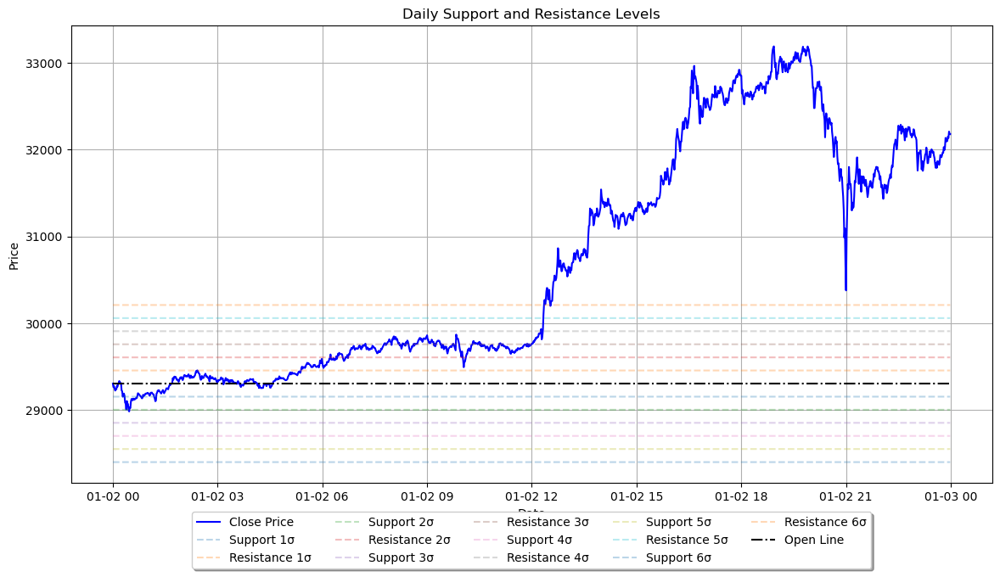

In [13]:
plot_daily_support_resistance(df_with_sigmas_added,
                              from_date='2021-01-02',
                              to_date='2021-01-02'
                              )

In [15]:
df = df_with_sigmas_added.copy()

Create entries and exits based on the support and resistance levels.

In [16]:
short_entries = (
    df['close'].vbt.crossed_above(df['daily_resistance_1']) |
    df['close'].vbt.crossed_above(df['daily_resistance_2']) |
    df['close'].vbt.crossed_above(df['daily_resistance_3']) |
    df['close'].vbt.crossed_above(df['daily_resistance_4']) |
    df['close'].vbt.crossed_above(df['daily_resistance_5']) |
    df['close'].vbt.crossed_above(df['daily_resistance_6'])
)

short_exits = (
    df['close'].vbt.crossed_below(df['daily_resistance_1']) |
    df['close'].vbt.crossed_below(df['daily_resistance_2']) |
    df['close'].vbt.crossed_below(df['daily_resistance_3']) |
    df['close'].vbt.crossed_below(df['daily_resistance_4']) |
    df['close'].vbt.crossed_below(df['daily_resistance_5']) |
    df['close'].vbt.crossed_below(df['daily_resistance_6'])
)

entries = (
    df['close'].vbt.crossed_below(df['daily_support_1']) |
    df['close'].vbt.crossed_below(df['daily_support_2']) |
    df['close'].vbt.crossed_below(df['daily_support_3']) |
    df['close'].vbt.crossed_below(df['daily_support_4']) |
    df['close'].vbt.crossed_below(df['daily_support_5']) |
    df['close'].vbt.crossed_below(df['daily_support_6'])
)

exits = (
    df['close'].vbt.crossed_above(df['daily_support_1']) |
    df['close'].vbt.crossed_above(df['daily_support_2']) |
    df['close'].vbt.crossed_above(df['daily_support_3']) |
    df['close'].vbt.crossed_above(df['daily_support_4']) |
    df['close'].vbt.crossed_above(df['daily_support_5']) |
    df['close'].vbt.crossed_above(df['daily_support_6'])
)    


In [18]:
filter = '2021'
entries.loc[filter]

Open time
2021-01-01 00:00:00+00:00    False
2021-01-01 00:01:00+00:00    False
2021-01-01 00:02:00+00:00    False
2021-01-01 00:03:00+00:00    False
2021-01-01 00:04:00+00:00    False
                             ...  
2021-12-31 23:55:00+00:00    False
2021-12-31 23:56:00+00:00    False
2021-12-31 23:57:00+00:00    False
2021-12-31 23:58:00+00:00    False
2021-12-31 23:59:00+00:00    False
Length: 524607, dtype: bool

In [20]:
# print the number of entries and exits, short entries and short exits
# sum() will count the number of True values
print(f'Number of entries: {entries.sum()}')
print(f'Number of exits: {exits.sum()}')
print(f'Number of short entries: {short_entries.sum()}')
print(f'Number of short exits: {short_exits.sum()}')


Number of entries: 11493
Number of exits: 11128
Number of short entries: 10464
Number of short exits: 10057


In [31]:
# Create a portfolio object from the signals
year = '2021' # prevents the backtest from running out of memory
pf = vbt.Portfolio.from_signals(
    close=df.loc[year]['close'],
    open = df.loc[year]['open'],
    high = df.loc[year]['high'],
    low = df.loc[year]['low'],
    entries=entries[year],
    exits=exits[year],
    short_entries=short_entries[year],
    short_exits=short_exits[year],
    leverage = 1,
    accumulate=True,
    # Play around with the following parameters for different results
    # size = 100,
    # size_type = 'value',
    # init_cash = 'auto',
    # max_orders = 3,

    # This is how i used to do size but I'm not sure if it's correct, Oleg told me to do it like the above section
    # size = .1,
    # size_type = 'percent',

    # Play around with stop losses and other exit strategies

    # td_stop=480, # Time Delta Stop Trigger
    # time_delta_format = 'Rows',
    # sl_stop=.08, # Stop Loss Trigger
    tsl_th = 0.02, # Trailing Stop Loss Profit Taking threshold
    tsl_stop = 0.01, # Trailing Stop Loss Trigger
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()

Start                         2021-01-01 00:00:00+00:00
End                           2021-12-31 23:59:00+00:00
Period                                364 days 07:27:00
Start Value                                     10000.0
Min Value                                   7262.318897
Max Value                                    30065.9099
End Value                                  25067.058892
Total Return [%]                             150.670589
Benchmark Return [%]                            59.5797
Total Time Exposure [%]                       31.213651
Max Gross Exposure [%]                       123.007281
Max Drawdown [%]                              30.983827
Max Drawdown Duration                 134 days 07:03:00
Total Orders                                      18435
Total Fees Paid                                     0.0
Total Trades                                       9218
Win Rate [%]                                  90.267983
Best Trade [%]                                 2

In [32]:
df.loc['2021-01-02'][['close', # you can play around with the dates here
                    'daily_support_1',
                    'daily_support_2', 
                    'daily_support_3',
                    'daily_support_4',
                    'daily_support_5',
                    'daily_support_6',
                    'open_line', 
                    'daily_resistance_1',
                    'daily_resistance_2',
                    'daily_resistance_3',
                    'daily_resistance_4',
                    'daily_resistance_5',
                    'daily_resistance_6',
                    
                    ]].vbt.plot(width= 1200, height=400).show()

In [33]:
pf['2021-01-02'].orders.plot().show()

### Looks like lots of entries and exits as the market hovers around support or resistance lines
Let's clean up some of the entries and exits so we aren't getting multiple buys before getting a sell order

In [34]:
clean_entries, clean_exits = entries.vbt.signals.clean(exits)
clean_short_entries, clean_short_exits = short_entries.vbt.signals.clean(short_exits)

In [35]:
# Print the number of entries and exits, short entries and short exits
# sum() will count the number of True values
print(f'Number of entries: {clean_entries.sum()}')
print(f'Number of exits: {clean_exits.sum()}')
print(f'Number of short entries: {clean_short_entries.sum()}')
print(f'Number of short exits: {clean_short_exits.sum()}')


Number of entries: 10390
Number of exits: 10390
Number of short entries: 9459
Number of short exits: 9459


Better, but still a lot of trades

In [39]:
# Create a portfolio object from the signals
year = '2021' # prevents the backtest from running out of memory
pf = vbt.Portfolio.from_signals(
    close=df.loc[year]['close'],
    open = df.loc[year]['open'],
    high = df.loc[year]['high'],
    low = df.loc[year]['low'],
    entries=clean_entries[year],
    exits=clean_exits[year],
    short_entries=clean_short_entries[year],
    short_exits=clean_short_exits[year],
    accumulate=True, # True or false shouldn't matter because we cleaned our entries and exits
    size = 100,
    size_type = 'value',
    init_cash = 'auto',
    leverage = 1,
    # max_orders = 3,
    # size = .1,
    # size_type = 'percent',
    # sl_stop=.08,
    # td_stop=480,
    # time_delta_format = 'Rows',
    # tsl_th = 0.02,
    # tsl_stop = 0.01,
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()

Start                         2021-01-01 00:00:00+00:00
End                           2021-12-31 23:59:00+00:00
Period                                364 days 07:27:00
Start Value                                  131.202734
Min Value                                    100.774005
Max Value                                    256.664534
End Value                                    240.966212
Total Return [%]                              83.659444
Benchmark Return [%]                            59.5797
Total Time Exposure [%]                       82.529779
Max Gross Exposure [%]                       100.886538
Max Drawdown [%]                              24.026548
Max Drawdown Duration                 134 days 07:03:00
Total Orders                                      18435
Total Fees Paid                                     0.0
Total Trades                                       9481
Win Rate [%]                                  90.094937
Best Trade [%]                                 6

## Try getting the signals but making sure they make sense

In [40]:
lookback = 1

# Long Entry Conditions
long_cond1 = df['close'].vbt.crossed_below(df['daily_support_1']) & ~df['close'].vbt.crossed_below(df['open_line']).vbt.rolling_any(lookback)
long_cond2 = df['close'].vbt.crossed_below(df['daily_support_2']) & ~df['close'].vbt.crossed_below(df['daily_support_1']).vbt.rolling_any(lookback)
long_cond3 = df['close'].vbt.crossed_below(df['daily_support_3']) & ~df['close'].vbt.crossed_below(df['daily_support_2']).vbt.rolling_any(lookback)
long_cond4 = df['close'].vbt.crossed_below(df['daily_support_4']) & ~df['close'].vbt.crossed_below(df['daily_support_3']).vbt.rolling_any(lookback)
long_cond5 = df['close'].vbt.crossed_below(df['daily_support_5']) & ~df['close'].vbt.crossed_below(df['daily_support_4']).vbt.rolling_any(lookback)
long_cond6 = df['close'].vbt.crossed_below(df['daily_support_6']) & ~df['close'].vbt.crossed_below(df['daily_support_5']).vbt.rolling_any(lookback)

long_cond_dict = {1: long_cond1,
                  2: long_cond2,
                  3: long_cond3,
                  4: long_cond4,
                  5: long_cond5,
                  6: long_cond6,}

# Long Exit Conditions
long_exit_cond1 = df['close'].vbt.crossed_above(df['daily_support_1'])
long_exit_cond2 = df['close'].vbt.crossed_above(df['daily_support_2'])
long_exit_cond3 = df['close'].vbt.crossed_above(df['daily_support_3'])
long_exit_cond4 = df['close'].vbt.crossed_above(df['daily_support_4'])
long_exit_cond5 = df['close'].vbt.crossed_above(df['daily_support_5'])
long_exit_cond6 = df['close'].vbt.crossed_above(df['daily_support_6'])
 
# Short Entry Conditions
short_cond1 = df['close'].vbt.crossed_above(df['daily_resistance_1']) & ~df['close'].vbt.crossed_above(df['open_line']).vbt.rolling_any(lookback)
short_cond2 = df['close'].vbt.crossed_above(df['daily_resistance_2']) & ~df['close'].vbt.crossed_above(df['daily_resistance_1']).vbt.rolling_any(lookback)
short_cond3 = df['close'].vbt.crossed_above(df['daily_resistance_3']) & ~df['close'].vbt.crossed_above(df['daily_resistance_2']).vbt.rolling_any(lookback)
short_cond4 = df['close'].vbt.crossed_above(df['daily_resistance_4']) & ~df['close'].vbt.crossed_above(df['daily_resistance_3']).vbt.rolling_any(lookback)
short_cond5 = df['close'].vbt.crossed_above(df['daily_resistance_5']) & ~df['close'].vbt.crossed_above(df['daily_resistance_4']).vbt.rolling_any(lookback)
short_cond6 = df['close'].vbt.crossed_above(df['daily_resistance_6']) & ~df['close'].vbt.crossed_above(df['daily_resistance_5']).vbt.rolling_any(lookback)

short_cond_dict = {1: short_cond1,
                    2: short_cond2,
                    3: short_cond3,
                    4: short_cond4,
                    5: short_cond5,
                    6: short_cond6,}


# Short Exit Conditions
short_exit_cond1 = df['close'].vbt.crossed_below(df['daily_resistance_1'])
short_exit_cond2 = df['close'].vbt.crossed_below(df['daily_resistance_2'])
short_exit_cond3 = df['close'].vbt.crossed_below(df['daily_resistance_3'])
short_exit_cond4 = df['close'].vbt.crossed_below(df['daily_resistance_4'])
short_exit_cond5 = df['close'].vbt.crossed_below(df['daily_resistance_5'])
short_exit_cond6 = df['close'].vbt.crossed_below(df['daily_resistance_6'])

# Create a mask to avoid highly volatile periods

avoid_long_cond = long_cond1.vbt.rolling_any(lookback) | long_cond2.vbt.rolling_any(lookback) | long_cond3.vbt.rolling_any(lookback) | long_cond4.vbt.rolling_any(lookback) | long_cond5.vbt.rolling_any(lookback) | long_cond6.vbt.rolling_any(lookback)
avoid_short_cond = short_cond1.vbt.rolling_any(lookback) | short_cond2.vbt.rolling_any(lookback) | short_cond3.vbt.rolling_any(lookback) | short_cond4.vbt.rolling_any(lookback) | short_cond5.vbt.rolling_any(lookback) | short_cond6.vbt.rolling_any(lookback)


# Create a mask for long entries and exits
long_entry_mask = (long_cond1 | long_cond2 | long_cond3 | long_cond4 | long_cond5 | long_cond6)
long_exit_mask = (long_exit_cond1 | long_exit_cond2 | long_exit_cond3 | long_exit_cond4 | long_exit_cond5 | long_exit_cond6) # & ~avoid_long_cond # TODO may want to remvoe the avoid_long_cond
# Create a mask for short entries and exits
short_mask = (short_cond1 | short_cond2 | short_cond3 | short_cond4 | short_cond5 | short_cond6)
short_exit_mask = (short_exit_cond1 | short_exit_cond2 | short_exit_cond3 | short_exit_cond4 | short_exit_cond5 | short_exit_cond6) # & ~avoid_short_cond # TODO may want to remvoe the avoid_short_cond

In [41]:
print(f'Long Entries {long_entry_mask.value_counts()}')
print(f'Long Exits {long_exit_mask.value_counts()}')
print(f'Short Entries {short_mask.value_counts()}')
print(f'Short Exits {short_exit_mask.value_counts()}')

# Count how many times we blew trhough six levels of support/resistance

for sigma_level in range(1,7):
    print(f'Number of times we blew through {sigma_level} levels of resistance with a {lookback} period lookback {short_cond_dict[sigma_level].value_counts()[1]}')
    print(f'Number of times we blew through {sigma_level} levels of support with a {lookback} period lookback {long_cond_dict[sigma_level].value_counts()[1]}')


Long Entries False    1234237
True       11487
dtype: int64
Long Exits False    1234596
True       11128
dtype: int64
Short Entries False    1235266
True       10458
dtype: int64
Short Exits False    1235667
True       10057
dtype: int64
Number of times we blew through 1 levels of resistance with a 1 period lookback 4859
Number of times we blew through 1 levels of support with a 1 period lookback 5663
Number of times we blew through 2 levels of resistance with a 1 period lookback 2517
Number of times we blew through 2 levels of support with a 1 period lookback 2792
Number of times we blew through 3 levels of resistance with a 1 period lookback 1460
Number of times we blew through 3 levels of support with a 1 period lookback 1330
Number of times we blew through 4 levels of resistance with a 1 period lookback 867
Number of times we blew through 4 levels of support with a 1 period lookback 873
Number of times we blew through 5 levels of resistance with a 1 period lookback 476
Number of ti

In [42]:
year = '2021'
pf = vbt.Portfolio.from_signals(
    close=df[year]['close'],
    open=df[year]['open'],
    high=df[year]['high'],
    low=df[year]['low'],
    entries=long_entry_mask[year],
    # exits=long_exit_mask[year],
    short_entries=short_mask[year],
    # short_exits=short_exit_mask[year],
    accumulate=False,
    size = 100,
    size_type = 'value',
    init_cash = 'auto',
    leverage = 1,
    # max_orders = 3,
    # size = .1,
    # size_type = 'percent',
    # sl_stop=.08,
    # td_stop=480,
    # time_delta_format = 'Rows',
    tsl_th = 0.01,
    tsl_stop = 0.005,
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()


/var/folders/dt/m1bsm13n187d7m0ssssp79ww0000gn/T/ipykernel_17687/3041883838.py:3: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.

/var/folders/dt/m1bsm13n187d7m0ssssp79ww0000gn/T/ipykernel_17687/3041883838.py:4: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.

/var/folders/dt/m1bsm13n187d7m0ssssp79ww0000gn/T/ipykernel_17687/3041883838.py:5: FutureWarning:

Indexing a DataFrame with a datetimelike index using a single string to slice the rows, like `frame[string]`, is deprecated and will be removed in a future version. Use `frame.loc[string]` instead.

/var/folders/dt/m1bsm13n187d7m0ssssp79ww0000gn/T/ipykernel_17687/3041883838.py:6: FutureWarning:

Indexing a 

Start                         2021-01-01 00:00:00+00:00
End                           2021-12-31 23:59:00+00:00
Period                                364 days 07:27:00
Start Value                                  110.414348
Min Value                                     88.642368
Max Value                                    235.067419
End Value                                    221.156122
Total Return [%]                             100.296543
Benchmark Return [%]                            59.5797
Total Time Exposure [%]                       80.037247
Max Gross Exposure [%]                       126.414687
Max Drawdown [%]                              20.961593
Max Drawdown Duration                 172 days 06:10:00
Total Orders                                       1347
Total Fees Paid                                     0.0
Total Trades                                        764
Win Rate [%]                                  84.141547
Best Trade [%]                                 3

There is some great documentation here on cleaning up the signals. Have a look at the following link https://vectorbt.pro/pvt_ff5db015/tutorials/signal-development/generation/#truth-value-testing

In [27]:
cols = df.columns
cols

Index(['open', 'high', 'low', 'close', 'volume', 'quote volume', 'trade count',
       'taker base volume', 'taker quote volume', 'close_daily_mean',
       'rolling_std_dev_daily_mean', 'open_line', 'daily_support_1',
       'daily_resistance_1', 'daily_support_2', 'daily_resistance_2',
       'daily_support_3', 'daily_resistance_3', 'daily_support_4',
       'daily_resistance_4', 'daily_support_5', 'daily_resistance_5',
       'daily_support_6', 'daily_resistance_6'],
      dtype='object')

## Working with Ranks in VBT
here is the link https://vectorbt.pro/pvt_ff5db015/tutorials/signal-development/pre-analysis/#preset-rankers

In the following cells I will mess around with ranks and clean up a lot of the signals. For this I'm just going to focus on a long only strategy.

In [48]:
# Here we are going to look at a long list of true or false signals but where we get a bunch of true's in a row
# from_nth(1) is the first time the signal is true and from_nth(2) is the second time the signal is true
# You can use this as a confirmation or perhaps a way to cool off by waiting for the signal to be true twice in a row

entry_sigma_cond1 = df['close'] < df['daily_support_1'] # true for all times that the close is below the daily support 1
entry_sigma_cond2 = df['close'] > df['daily_support_2'] # true for all times that the close is above the daily support 2

entries = entry_sigma_cond1 & entry_sigma_cond1
print(f'{entries.vbt.signals.from_nth(1).sum()}') # from_nth(1) is the first time the signal is true
print(f'{entries.vbt.signals.from_nth(200).sum()}')
print(f'{entries.vbt.signals.from_nth(300).sum()}') # from_nth(300) is the 300th time the signal is true

exit_sigma_cond1 = df['close'] > df['open_line']

exits = exit_sigma_cond1
print(f'{exits.vbt.signals.from_nth(1).sum()}') # from_nth(1) is the first time the signal is true
print(f'{exits.vbt.signals.from_nth(200).sum()}')
print(f'{exits.vbt.signals.from_nth(300).sum()}') # from_nth(300) is the 300th time the signal is true

255900
125955
97323
604281
330588
266693


In [49]:
# The following line will return the number of bars between entry and exit so by taking the max we get the longest trade
exits.vbt.signals.pos_rank_after(entries, reset_wait=0).max() +1 # max() +1 is the max number of bars between entry and exit

7931

In [50]:
# The following line of code will give you the max number of bars between entry and exit
entries.vbt.signals.pos_rank_after(exits).max() + 1

2696

In [51]:
# Here we are using vbt.signals.clean to remove any overlapping entries and exits. This is useful if you have multiple entry signals and you want to make sure you don't have overlapping entries and exits.

new_entries, new_exits = entries.vbt.signals.clean(exits)

In [52]:
# Since these are boolean series, we can sum them to get the total number of entries and exits
print(f'New Entries {new_entries.sum()} and New Exits {new_exits.sum()}')

New Entries 788 and New Exits 787


When dealing with two masks, such as entry and exit signals, we're more likely interested in assessing the space between signals of both masks rather than signals in each mask separately. This can be realized by a mapping procedure that goes one signal at a time in the first mask and looks for one to many succeeding signals in the second mask, up until the next signal in the first mask. Such a procedure is implemented by the Numba-compiled function between_two_ranges_nb. The accessor method is the same as above - SignalsAccessor.between_ranges, which switches to the second mode if the argument other is specified. For example, let's get the average distance from each entry signal to its succeeding exit signal before and after cleaning:

In [53]:
ranges = entries.vbt.signals.between_ranges(other=exits)

print(f'The average time delta between trades on the uncleaned signals is {ranges.avg_duration}')

The average time delta between trades on the uncleaned signals is 0 days 22:12:03.737548927


In [54]:
new_ranges = new_entries.vbt.signals.between_ranges(other=new_exits)
print(f'The average time delta between trades on the cleaned signals is {new_ranges.avg_duration}')


The average time delta between trades on the cleaned signals is 0 days 08:11:30.648030495


In [55]:
# The following code will give you a better understanding of the data
ranges.duration.describe(wrap_kwargs=dict(to_timedelta=True))

mean   0 days 22:12:03.737548927
std    0 days 21:54:46.481341055
min              0 days 00:01:00
25%              0 days 07:18:00
50%              0 days 16:02:00
75%              1 days 05:36:00
max              6 days 18:57:00
dtype: timedelta64[ns]

In [56]:
new_ranges.duration.describe(wrap_kwargs=dict(to_timedelta=True))

mean   0 days 08:11:30.648030495
std    0 days 07:29:50.828184182
min              0 days 00:02:00
25%              0 days 02:20:00
50%              0 days 05:45:00
75%              0 days 11:53:30
max              1 days 23:48:00
dtype: timedelta64[ns]

In [57]:
entries.vbt.signals.stats() # This will give you the stats for the uncleaned signals

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-16 19:56:00+00:00
Period                                865 days 02:04:00
Total                                            261569
Rate [%]                                      20.997348
First Index                   2021-01-02 00:17:00+00:00
Last Index                    2023-05-16 19:55:00+00:00
Norm Avg Index [-1, 1]                        -0.053944
Distance: Min                           0 days 00:01:00
Distance: Median                        0 days 00:01:00
Distance: Max                           6 days 20:28:00
Total Partitions                                   5669
Partition Rate [%]                             2.167306
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:03:00
Partition Length: Max                   0 days 23:28:00
Partition Distance: Min                 0 days 00:02:00
Partition Distance: Median              0 days 0

In [58]:
exits.vbt.signals.stats()

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-16 19:56:00+00:00
Period                                865 days 02:04:00
Total                                            614268
Rate [%]                                       49.31012
First Index                   2021-01-01 00:01:00+00:00
Last Index                    2023-05-16 09:30:00+00:00
Norm Avg Index [-1, 1]                         -0.00995
Distance: Min                           0 days 00:01:00
Distance: Median                        0 days 00:01:00
Distance: Max                           2 days 00:02:00
Total Partitions                                   9987
Partition Rate [%]                             1.625838
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:04:00
Partition Length: Max                   0 days 23:59:00
Partition Distance: Min                 0 days 00:02:00
Partition Distance: Median              0 days 0

In [59]:
new_entries.vbt.signals.stats() # This will give you the stats for the cleaned signals

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-16 19:56:00+00:00
Period                                865 days 02:04:00
Total                                               788
Rate [%]                                       0.063256
First Index                   2021-01-02 00:17:00+00:00
Last Index                    2023-05-16 14:10:00+00:00
Norm Avg Index [-1, 1]                        -0.027141
Distance: Min                           0 days 00:14:00
Distance: Median                        0 days 20:00:00
Distance: Max                           6 days 23:16:00
Total Partitions                                    788
Partition Rate [%]                                100.0
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:01:00
Partition Length: Max                   0 days 00:01:00
Partition Distance: Min                 0 days 00:14:00
Partition Distance: Median              0 days 2

In [60]:
new_exits.vbt.signals.stats()

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-16 19:56:00+00:00
Period                                865 days 02:04:00
Total                                               787
Rate [%]                                       0.063176
First Index                   2021-01-02 01:41:00+00:00
Last Index                    2023-05-16 07:19:00+00:00
Norm Avg Index [-1, 1]                        -0.027656
Distance: Min                           0 days 00:28:00
Distance: Median                        0 days 21:33:30
Distance: Max                           6 days 14:14:00
Total Partitions                                    787
Partition Rate [%]                                100.0
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:01:00
Partition Length: Max                   0 days 00:01:00
Partition Distance: Min                 0 days 00:28:00
Partition Distance: Median              0 days 2

In [69]:
# Plot the entries and exits
(new_entries.astype(int) - new_exits.astype(int))\
    .resample("1d").sum()\
    .vbt.ts_heatmap(
        trace_kwargs=dict(
            colorscale=["#ef553b", "rgba(0, 0, 0, 0)", "#17becf"],
            colorbar=dict(
                tickvals=[-1, 0, 1], 
                ticktext=["Exit", "", "Entry"]
            )
        )
    ).show()  

### Run a long only analysis
Let's have a look at this simple strategy that we created above

In [63]:
year = '2021'

pf = vbt.Portfolio.from_signals(
    close=df.loc[year]['close'],
    open=df.loc[year]['open'],
    high=df.loc[year]['high'],
    low=df.loc[year]['low'],
    entries=new_entries.loc[year],
    exits=new_exits.loc[year],
    # short_entries=short_mask[year],
    # short_exits=short_exit_mask[year],
    accumulate=False, # Set this to True and see the difference.
    size = 100,
    size_type = 'value',
    init_cash = 'auto',
    leverage = 1,
    # max_orders = 3,
    # size = .1,
    # size_type = 'percent',
    # sl_stop=.01,
    # td_stop=480,
    # time_delta_format = 'Rows',
    # tsl_th = 0.01,
    # tsl_stop = 0.005,
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
vbt.settings.plotting["layout"]["width"] = 600
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()


Start                         2021-01-01 00:00:00+00:00
End                           2021-12-31 23:59:00+00:00
Period                                364 days 07:27:00
Start Value                                  101.138333
Min Value                                     87.348242
Max Value                                    220.044489
End Value                                    205.576592
Total Return [%]                             103.262784
Benchmark Return [%]                            59.5797
Total Time Exposure [%]                       33.244314
Max Gross Exposure [%]                            100.0
Max Drawdown [%]                              21.906505
Max Drawdown Duration                  55 days 06:02:00
Total Orders                                        689
Total Fees Paid                                     0.0
Total Trades                                        345
Win Rate [%]                                  71.511628
Best Trade [%]                                 3

Not bad actually. 

In [70]:
# To understand what is happening under the hood show the trades
pf.trades.records_readable # This will show you the trades the records_readable is a handy method to simplify the output

,Exit Trade Id,Column,Size,Entry Order Id,Entry Index,Avg Entry Price,Entry Fees,Exit Order Id,Exit Index,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id
0,0,0,0.003430,0,2021-01-02 00:17:00+00:00,29154.19,0.0,1,2021-01-02 01:41:00+00:00,29306.04,0.0,0.520851,0.005209,Long,Closed,0
1,1,0,0.003087,2,2021-01-04 07:17:00+00:00,32395.04,0.0,3,2021-01-05 00:01:00+00:00,32112.63,0.0,-0.871769,-0.008718,Long,Closed,1
2,2,0,0.003191,4,2021-01-05 03:48:00+00:00,31336.59,0.0,5,2021-01-05 14:51:00+00:00,32133.20,0.0,2.542108,0.025421,Long,Closed,2
3,3,0,0.003000,6,2021-01-06 00:23:00+00:00,33338.46,0.0,7,2021-01-06 02:08:00+00:00,34052.95,0.0,2.143140,0.021431,Long,Closed,3
4,4,0,0.002584,8,2021-01-08 01:05:00+00:00,38703.62,0.0,9,2021-01-08 10:06:00+00:00,39500.00,0.0,2.057637,0.020576,Long,Closed,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
340,340,0,0.002012,680,2021-12-26 03:39:00+00:00,49713.99,0.0,681,2021-12-26 16:45:00+00:00,50372.25,0.0,1.324094,0.013241,Long,Closed,340
341,341,0,0.002000,682,2021-12-28 01:32:00+00:00,50000.00,0.0,683,2021-12-29 00:06:00+00:00,47608.85,0.0,-4.782300,-0.047823,Long,Closed,341
342,342,0,0.002131,684,2021-12-29 12:12:00+00:00,46927.83,0.0,685,2021-12-29 14:34:00+00:00,47721.80,0.0,1.691896,0.016919,Long,Closed,342
343,343,0,0.002150,686,2021-12-29 23:20:00+00:00,46501.45,0.0,687,2021-12-30 00:01:00+00:00,46538.43,0.0,0.079524,0.000795,Long,Closed,343


# Everything below is incomplete and WIP

# Working with pattern recognition

In [71]:
data = vbt.Data.from_data(df)

In [72]:
data_window = data.loc['2021-01-01':'2021-01-31']

In [73]:
# Use the typical price (average of high, low, close) to smooth out the data
price_window = data_window.hlc3
price_window.vbt.plot().show()

This 👆 section is incomplete. 

# Work on multi time frame for bollinger band support and resistance levels

In [45]:
# Create a resampled dataframe
# Create a dict for all the columns in the dataframe 


resample_dict = {'open': 'first', 'high': 'max', 'low': 'min', 
                 'close': 'last', 'volume': 'sum', 'quote volume': 'sum', 
                 'trade count': 'sum', 'taker base volume': 'sum', 
                 'taker quote volume': 'sum', 'close_daily_mean': 'mean', 
                 'rolling_std_dev_daily_mean': 'mean', 'daily_support_1': 'mean', 
                 'daily_resistance_1': 'mean', 'daily_support_2': 'mean', 
                 'daily_resistance_2': 'mean', 'daily_support_3': 'mean', 
                 'daily_resistance_3': 'mean', 'daily_support_4': 'mean', 
                 'daily_resistance_4': 'mean', 'daily_support_5': 'mean', 
                 'daily_resistance_5': 'mean', 'daily_support_6': 'mean', 
                 'daily_resistance_6': 'mean', 'open_line': 'mean'}

df_resampled = df.resample('1D').agg(resample_dict)

In [46]:

h1_data = df.resample('1H').agg(resample_dict)

In [47]:
h1_data.close

Open time
2021-01-01 00:00:00+00:00    28995.13
2021-01-01 01:00:00+00:00    29409.99
2021-01-01 02:00:00+00:00    29194.65
2021-01-01 03:00:00+00:00    29278.40
2021-01-01 04:00:00+00:00    29220.31
                               ...   
2023-05-16 15:00:00+00:00    27038.02
2023-05-16 16:00:00+00:00    27052.83
2023-05-16 17:00:00+00:00    27086.56
2023-05-16 18:00:00+00:00    27051.78
2023-05-16 19:00:00+00:00    26954.14
Freq: H, Name: close, Length: 20780, dtype: float64

In [48]:
def generate_bandwidths(freqs):
    bandwidths = []
    for freq in freqs:
        close = h1_data['close'].resample(freq)
        bbands = vbt.talib("BBANDS").run(close, skipna=True)
        upperband = bbands.upperband.ffill()
        middleband = bbands.middleband.ffill()
        lowerband = bbands.lowerband.ffill()
        bandwidth = (upperband - lowerband) / middleband
        bandwidths.append(bandwidth.vbt.resample_closing("1h"))  
        print(bandwidths)
    df = pd.concat(bandwidths, axis=1, keys=pd.Index(freqs, name="timeframe"))  
    return df.ffill()  

bandwidths = generate_bandwidths(["1h", "4h", "1d", "7d"])
bandwidths

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 2 dimensions. The detected shape was (20780, 2) + inhomogeneous part.

In [ ]:
bandwidths.loc[:, ::-1].vbt.ts_heatmap().show()

In [ ]:
bbands = vbt.talib("BBANDS").run(
    h1_data.get("Close"), 
    skipna=True, 
    timeframe=["1h", "4h", "1d", "7d"],
    broadcast_kwargs=dict(wrapper_kwargs=dict(freq="1h"))  
)
bandwidth = (bbands.upperband - bbands.lowerband) / bbands.middleband
bandwidths

In [ ]:
def generate_signals(data, freq, fast_window, slow_window):
    open_price = data.resample(freq).get("Open")  
    fast_sma = vbt.talib("SMA")\
        .run(
            open_price, 
            fast_window, 
            skipna=True, 
            short_name="fast_sma"
        )\
        .real.ffill()\  
        .vbt.latest_at_index(data.wrapper.index)  
    slow_sma = vbt.talib("SMA")\
        .run(
            open_price, 
            slow_window, 
            skipna=True, 
            short_name="slow_sma"
        )\
        .real.ffill()\
        .vbt.latest_at_index(data.wrapper.index)
    entries = fast_sma.vbt.crossed_above(slow_sma)  
    exits = fast_sma.vbt.crossed_below(slow_sma)
    return entries, exits

fast_window = [10, 20]  
slow_window = [20, 30]
h1_entries, h1_exits = generate_signals(h1_data, "1h", fast_window, slow_window)
h4_entries, h4_exits = generate_signals(h1_data, "4h", fast_window, slow_window)
d1_entries, d1_exits = generate_signals(h1_data, "1d", fast_window, slow_win

entries = pd.concat(  
    (h1_entries, h4_entries, d1_entries), 
    axis=1, 
    keys=pd.Index(["1h", "4h", "1d"], name="timeframe")
)
exits = pd.concat(
    (h1_exits, h4_exits, d1_exits), 
    axis=1, 
    keys=pd.Index(["1h", "4h", "1d"], name="timeframe")


(entries.astype(int) - exits.astype(int))\
    .resample("1d").sum()\
    .vbt.ts_heatmap(
        trace_kwargs=dict(
            colorscale=["#ef553b", "rgba(0, 0, 0, 0)", "#17becf"],
            colorbar=dict(
                tickvals=[-1, 0, 1], 
                ticktext=["Exit", "", "Entry"]
            )
        )
    ).show()  


In [64]:
(entries.astype(int) - exits.astype(int))\
    .resample("1d").sum()\
    .vbt.ts_heatmap(
        trace_kwargs=dict(
            colorscale=["#ef553b", "rgba(0, 0, 0, 0)", "#17becf"],
            colorbar=dict(
                tickvals=[-1, 0, 1], 
                ticktext=["Exit", "", "Entry"]
            )
        )
    ).show()  